Aufgabe 3
============

In [ ]:
import matplotlib.pylab as plt
%matplotlib inline
from IPPerfMonitor import IPPerfMonitor
import IPBasicPRM
import IPVISBasicPRM

import IPVisibilityPRM
import IPVISVisibilityPRM

import IPLazyPRM
import IPVISLazyPRM

import IPAStar
import IPVISAStar

## Visualizing the information

In [10]:
import networkx as nx
import matplotlib.pyplot as plt
 
def visualizePRMMulti(prm_instance, solution, ax=None):
    """
✔ Graph (alle Knoten, alle Kanten)
→ nur Roboter 1 → Projektion in 2D (ist eigentlich ein schatten des richtigen 6D-PRM)
→ sinnvoll, weil 6D unplottbar

✔ Lösungspfad
→ beide Roboter einzeln
→ jeder nach seiner eigenen (x,y)-Sequenz
→ daher siehst du zwei unterschiedliche Pfade, was korrekt ist
    """
   
    graph = prm_instance.graph
    collChecker = prm_instance._collisionChecker
   
    if ax is None:
        fig_local = plt.figure(figsize=(10,10))
        ax = fig_local.add_subplot(1,1,1)
 
    # 1. Ein Knoten im C-Space hat 6 Einträge --> [X1,Y1,Theta, X2,Y2,Theta]
    pos_6d = nx.get_node_attributes(graph, 'pos')
   
    # 2. Projektion in 2D für den Graphen
    # Hinweis: Vereinfachung, es wird nur die Position von Roboter 1 zum Plotten des Graphen verwendet
    pos_2d_for_graph = {node: (config[0], config[1]) for node, config in pos_6d.items()}
   
    # 3. Zeichne die Hindernisse
    collChecker.drawObstacles(ax)
   
    # 4. Zeichne die Knoten und Kanten des Graphen (basierend auf der Position von R1)
    if pos_2d_for_graph:
        nx.draw_networkx_nodes(graph, pos_2d_for_graph, ax=ax, node_size=10, node_color='gray')
        nx.draw_networkx_edges(graph, pos_2d_for_graph, ax=ax, edge_color='lightgray', alpha=0.5)
 
    # Positionen für Roboter 1 (x1,y1)
    pos_r1 = {node: (config[0], config[1]) for node, config in pos_6d.items()}
    # Positionen für Roboter 2 (x2,y2)
    pos_r2 = {node: (config[3], config[4]) for node, config in pos_6d.items()}
 
    # 5. Zeichne den Lösungsweg für beide Roboter (falls vorhanden) in den gleichen C-Space
    if solution:
        Gsp = nx.subgraph(graph, solution)
    
        # Kanten für Roboter 1 zeichnen (z.B. grün)
        nx.draw_networkx_edges(Gsp, pos_r1, edge_color='g', width=3, ax=ax)
        # Kanten für Roboter 2 zeichnen (z.B. blau)
        nx.draw_networkx_edges(Gsp, pos_r2, edge_color='b', width=3, ax=ax)
    
        # Roboterpositionen auf dem Pfad zeichnen (beide Roboter an jedem Schritt)
        for node_id in solution:
            if node_id in pos_6d:
                config_6d = pos_6d[node_id]
                collChecker.drawRobots(ax, config_6d, alpha=0.5)  # leicht transparent
 
    # 6. Zeichne die Roboter (orientiert) an jedem Schritt des Pfades
    if solution:
        for node_id in solution:
            if node_id in pos_6d:
                config_6d = pos_6d[node_id]
                collChecker.drawRobots(ax, config_6d, alpha=0.5) # sehr transparent
 
    # 7. Zeichne Start- und Zielkonfigurationen (stark sichtbar)
    if "start" in graph.nodes():
        start_config = pos_6d["start"]
        collChecker.drawRobots(ax, start_config, colors=['darkgreen', 'red'], alpha=0.8)
 
    if "goal" in graph.nodes():
        goal_config = pos_6d["goal"]
        collChecker.drawRobots(ax, goal_config, colors=['darkgreen', 'red'], alpha=0.8)
 
    # Anzeigeeinstellungen
    ax.set_aspect('equal')
    ax.set_xlim(collChecker.getEnvironmentLimits()[0]) # X-Limits für Roboter 1
    ax.set_ylim(collChecker.getEnvironmentLimits()[1]) # Y-Limits für Roboter 1

## Animation

In [20]:
import matplotlib.animation as animation
from IPython.display import HTML, display
import copy
import numpy as np
import matplotlib.pyplot as plt

# Hilfsfunktion (unverändert, aber wir behandeln den Rückgabewert jetzt besser)
def _interpolate_line(startPos, endPos, step_l):
    steps = []
    line = np.array(endPos) - np.array(startPos)
    line_l = np.linalg.norm(line)
    if line_l == 0:
        return [np.array(startPos)]
    step = line / line_l * step_l
    n_steps = int(np.floor(line_l / step_l))
    c_step = np.array(startPos, dtype=float)
    for i in range(n_steps):
        steps.append(copy.deepcopy(c_step))
        c_step = c_step + step
    if not np.allclose(c_step, np.array(endPos)):
        steps.append(np.array(endPos, dtype=float))
    return steps

def animate_solution_multi_downsampled(prm, environment, solution, visualizer=None, 
                                     workSpaceLimits=None, step_l=0.1, interval=50, 
                                     max_frames=250, figsize=(6,6), dpi=70, 
                                     pause_frames=40):
    
    # 1. Basic Checks
    if not solution or len(solution) < 2:
        raise ValueError('solution must contain at least two nodes')

    # 2. Limits
    env_limits = environment.getEnvironmentLimits()
    if workSpaceLimits is None:
        workSpaceLimits = [env_limits[0], env_limits[1]]

    # 3. Pfad interpolieren (ROBUSTERE LOGIK)
    solution_pos = [prm.graph.nodes[node]['pos'] for node in solution]
    full_interpolated_path = [solution_pos[0]]
    
    for i in range(1, len(solution_pos)):
        seg_s = solution_pos[i-1]
        seg_e = solution_pos[i]
        seg_steps = _interpolate_line(seg_s, seg_e, step_l)
        
        # FIX: Wenn das Segment sehr kurz ist (kürzer als step_l), 
        # gibt interpolate_line nur [EndPos] zurück.
        # Das slicing [1:] würde dann eine leere Liste erzeugen und das Ziel löschen.
        if len(seg_steps) == 1:
            # Wenn nur ein Punkt zurückkommt, ist es das Ziel -> anhängen!
            full_interpolated_path.append(seg_steps[0])
        else:
            # Normaler Fall: Startpunkt überspringen, da schon vorhanden
            full_interpolated_path.extend(seg_steps[1:])

    # SICHERHEITSNETZ: Das absolute Ziel explizit als letzten Frame setzen
    # (verhindert kleine Lücken durch Floating-Point Fehler)
    full_interpolated_path[-1] = solution_pos[-1]

    total_frames_calculated = len(full_interpolated_path)

    # 4. Downsampling
    if total_frames_calculated > max_frames:
        print(f"Downsampling: {total_frames_calculated} -> {max_frames} Frames.")
        indices = np.linspace(0, total_frames_calculated - 1, max_frames).astype(int)
        frames_data = [full_interpolated_path[i] for i in indices]
    else:
        frames_data = full_interpolated_path

    # 5. Pause am Ende
    if pause_frames > 0:
        last_pos = frames_data[-1]
        frames_data.extend([last_pos] * pause_frames)

    # 6. Setup Figure
    if visualizer is None:
        fig_local = plt.figure(figsize=figsize, dpi=dpi)
        ax_ws = fig_local.add_subplot(1,1,1)
        ax_cs = None
    else:
        fig_local = plt.figure(figsize=(figsize[0]*2, figsize[1]) if figsize[0]==figsize[1] else figsize, dpi=dpi)
        ax_ws = fig_local.add_subplot(1,2,1)
        ax_cs = fig_local.add_subplot(1,2,2)

    # 7. Animation Loop (Direkte Datenübergabe statt Index)
    def _animate(cfg):
        ax_ws.cla()
        ax_ws.set_xlim(workSpaceLimits[0])
        ax_ws.set_ylim(workSpaceLimits[1])
        
        environment.drawObstacles(ax_ws)
        environment.drawRobots(ax_ws, cfg, alpha=0.7)
        
        if ax_cs is not None:
            ax_cs.cla()
            visualizer(prm, solution, ax_cs)
            try:
                ax_cs.scatter(cfg[0], cfg[1], color='r', zorder=10, s=80)
            except Exception:
                pass

    print(f"Rendere Animation ({len(frames_data)} Frames)...")
    
    # WICHTIG: Wir übergeben frames_data direkt an frames. 
    # Dadurch wird _animate(cfg) für jedes Element in der Liste aufgerufen.
    # Das verhindert Index-Fehler und stellt sicher, dass der letzte Punkt gerendert wird.
    ani = animation.FuncAnimation(fig_local, _animate, frames=frames_data, interval=interval)
    
    html = HTML(ani.to_jshtml())
    display(html)
    plt.close()
    return ani

## Berechnung Pfadlängen

In [16]:
def compute_path_lengths_multi(graph, solution, theta_in_radians=True):
    """
    Berechnet die Gesamtpfadläng pro Roboter in einem Graphen mit mehreren Robotern

    Das Knotenattribut 'pos' ist eine sequenz [x1,y1,theta1, x2,y2,theta2,...]
    Für unsere zwei Roboter sind es 6 Einträge pro Knoten.
    Die Funktion summiert die euklidischen Distanzen zwischen jedem Knotenpaar (Kanten) in der xy-Ebene für jeden Roboter auf.
    """
    import numpy as np
    import networkx as nx

    # Falls keine Lösung oder nur ein Knoten vorhanden ist, sofort Nullwerte zurückgeben
    if not solution or len(solution) < 2:
        return {
            'green': {'total': 0.0},
            'red': {'total': 0.0},
            'segments': 0
        }

    # Hole alle 'pos' Attribute aus dem Graph (dict: node -> config)
    pos_attr = nx.get_node_attributes(graph, 'pos')
    total_g = 0.0  # aufsummierte Distanz für grünen Roboter (Roboter 1)
    total_r = 0.0  # aufsummierte Distanz für roten Roboter (Roboter 2)
    segments = 0   # Anzahl der Segmente (Anzahl Kanten im Pfad)

    # Iteriere über alle aufeinanderfolgenden Knotenpaare der Lösung
    for i in range(len(solution) - 1):
        a = solution[i]; b = solution[i + 1]
        # Fehler, falls ein Knoten kein 'pos' Attribut hat (schützt vor inkonsistenten Graphen)
        if a not in pos_attr or b not in pos_attr:
            raise ValueError(f"Node {a} or {b} missing 'pos' attribute in graph")
        pa = np.array(pos_attr[a], dtype=float)  # Konfiguration an Knoten a
        pb = np.array(pos_attr[b], dtype=float)  # Konfiguration an Knoten b

        # Berechne Euklidische Distanz in der xy‑Ebene für Roboter 1 (grün)
        # pa[0:2] und pb[0:2] sind [x1,y1] für Roboter 1
        total_g += float(np.linalg.norm(pb[0:2] - pa[0:2]))

        # Berechne Euklidische Distanz in der xy‑Ebene für Roboter 2 (rot)
        # pa[3:5] und pb[3:5] sind [x2,y2] für Roboter 2
        total_r += float(np.linalg.norm(pb[3:5] - pa[3:5]))

        segments += 1  # ein weiteres Kanten-Segment wurde betrachtet

    # Rückgabe: pro Roboter nur die 'total' Länge (Rotationen werden hier bewusst nicht berücksichtigt)
    return {
        'green': {'total': total_g},
        'red': {'total': total_r},
        'segments': segments
    }

Set-up of the test scenario and the configuration for all planner
===================================

In [ ]:
plannerFactory = dict()

basicConfig = dict()
basicConfig["radius"] = 5
basicConfig["numNodes"] = 2000
plannerFactory["basePRM"] = [IPBasicPRM.BasicPRM, basicConfig, visualizePRMMulti]

#basicConfig2 = dict()
#basicConfig2["radius"] = 6
#basicConfig2["numNodes"] = 6000
#plannerFactory["basePRM2"] = [IPBasicPRM.BasicPRM, basicConfig2, visualizePRMMulti]

visbilityConfig = dict()
visbilityConfig["ntry"] = 300
plannerFactory["visibilityPRM"] = [IPVisibilityPRM.VisPRM, visbilityConfig, visualizePRMMulti]

lazyConfig = dict()
lazyConfig["initialRoadmapSize"] = 10
lazyConfig["updateRoadmapSize"]  = 5 
lazyConfig["kNearest"] = 8
lazyConfig["maxIterations"] = 20
plannerFactory["lazyPRM"] = [IPLazyPRM.LazyPRM, lazyConfig, visualizePRMMulti]

astarConfig = dict()
astarConfig["heuristic"] = 'euclidean' 
astarConfig["w"]  = 0.5
plannerFactory["astar"] = [IPAStar.AStar, astarConfig, visualizePRMMulti]

#astarConfig2 = dict()
#astarConfig2["heuristic"] = 'euclidean' 
#astarConfig2["w"]  = 0.9
#plannerFactory["astar2"] = [IPAStar.AStar, astarConfig2, visualizePRMMulti]



In [4]:
class ResultCollection (object):
    
    def __init__(self, plannerFactoryName, planner, benchmark, solution, perfDataFrame):
        self.plannerFactoryName = plannerFactoryName
        self.planner = planner
        self.benchmark = benchmark
        self.solution = solution
        self.perfDataFrame = perfDataFrame

## Selection of the environment, the robot, and the start and goal points

In [14]:
from IPBenchmark import Benchmark 
from IPEnvironment import CollisionChecker
from Collisionchecker2D import CollisionChecker2D
from Collisionchecker3Dmit2Roboter import Collisionchecker3Dmit2Roboter
from shapely.geometry import Point, Polygon, LineString
from shapely import plotting
import shapely.affinity
import math
import numpy as np

benchList= list()

# Definition der Hindernisse im Arbeitsraum (= Konfigurationraum)
MyField = dict()
MyField["obs1"] = Polygon([(0.5, 13), (6, 13), (6, 15), (0.5, 15)]).buffer(0.5)
MyField["obs3"] = Polygon([(18, 13), (21.5, 13), (21.5, 15), (18, 15)]).buffer(0.5)
MyField["obs2"] = Polygon([(9, 6),(13, 6),(11, 7.5)]).buffer(0.5)
MyField["obs4"] = Polygon([(10, 22),(12, 22),(11, 19.5)]).buffer(0.2)
description = ""

start = [[2, 20, 0,   19, 19, 0]] # [R1Start R2Start]
goal  = [[19, 2, math.pi,   2, 2, math.pi/2]] # [R1Ziel R2Ziel]

# Roboterabmessungen 
l_width = 2.0
l_height = 2.0
l_thickness = 0.5

# Umgebungsgrenzen für beide Roboter
lims_2d = [[0.0, 22.0], [0.0, 22.0]]
lims_t = [-math.pi, math.pi]
env_limits = lims_2d + [lims_t] + lims_2d + [lims_t]

benchList.append(Benchmark("MyField", Collisionchecker3Dmit2Roboter(MyField,l_width, l_height, l_thickness, limits=env_limits), start, goal, description, 2))

fullBenchList = benchList


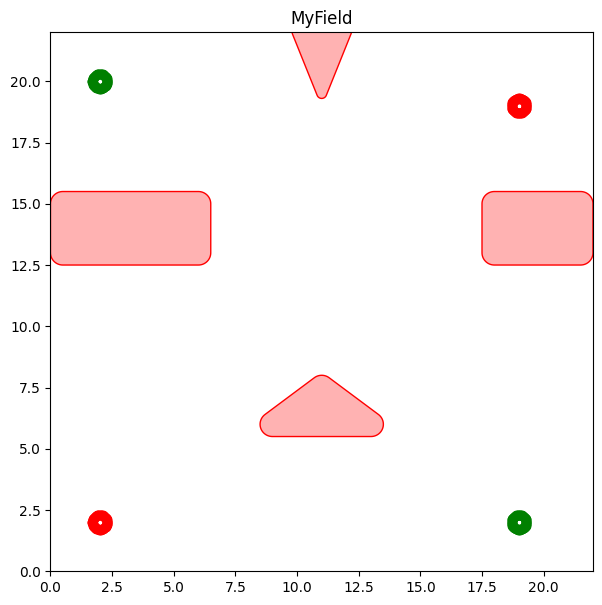

In [6]:
for benchmark in fullBenchList:
    fig_local = plt.figure(figsize=(7,7))
    ax = fig_local.add_subplot(1,1,1)
    title = benchmark.name
    ax.set_title(title)
    ax.set_xlim(benchmark.collisionChecker.getEnvironmentLimits()[0])
    ax.set_ylim(benchmark.collisionChecker.getEnvironmentLimits()[1])
    plotting.plot_points(Point(benchmark.startList[0][0:2]).buffer(.3), color="g", ax=ax)
    plotting.plot_points(Point(benchmark.startList[0][3:5]).buffer(.3), color="r", ax=ax)
    plotting.plot_points(Point(benchmark.goalList[0][0:2]).buffer(.3), color="g", ax=ax)
    plotting.plot_points(Point(benchmark.goalList[0][3:5]).buffer(.3), color="r", ax=ax)
    #try:
    benchmark.collisionChecker.drawObstacles(ax)
    
        
    #except  as e:
    #    print ("Error", e)
    #    pass

    Exception

In [7]:
resultList = list()
testList = fullBenchList

for key,producer in list(plannerFactory.items()):
    print(key, producer)
    for benchmark in testList:
        print ("Planning: " + key + " - " + benchmark.name)
        #planner = IPBasicPRM.BasicPRM(benchmark.collisionChecker)
        planner = producer[0](benchmark.collisionChecker)
        IPPerfMonitor.clearData()
        try:
            
            resultList.append(ResultCollection(key,
                                          planner, 
                                           benchmark, 
                                           planner.planPath(benchmark.startList,benchmark.goalList,producer[1]),
                                           IPPerfMonitor.dataFrame()
                                          ),
                        )
        except Exception as e:
        #    throw e
            print ("PLANNING ERROR ! PLANNING ERROR ! PLANNING ERROR ", e)
            pass
            



visibilityPRM [<class 'IPVisibilityPRM.VisPRM'>, {'ntry': 300}, <function visualizePRMMulti at 0x7fc45877ed40>]
Planning: visibilityPRM - MyField
lazyPRM [<class 'IPLazyPRM.LazyPRM'>, {'initialRoadmapSize': 10, 'updateRoadmapSize': 5, 'kNearest': 8, 'maxIterations': 20}, <function visualizePRMMulti at 0x7fc45877ed40>]
Planning: lazyPRM - MyField
astar [<class 'IPAStar.AStar'>, {'heuristic': 'euclidean', 'w': 0.5}, <function visualizePRMMulti at 0x7fc45877ed40>]
Planning: astar - MyField


## Path length

In [18]:
for result in resultList:
    try:
        res = compute_path_lengths_multi(result.planner.graph, result.solution, theta_in_radians=True)
        print(result.plannerFactoryName)
        print(f"Green robot total={res['green']['total']:.3f}")
        print(f"Red robot total  ={res['red']['total']:.3f}")
    except Exception as e:
        print("Error computing path lengths:", e)

visibilityPRM
Green robot total=28.681
Red robot total  =28.593
lazyPRM
Green robot total=32.218
Red robot total  =27.745
astar
Green robot total=0.000
Red robot total  =0.000


## Results 

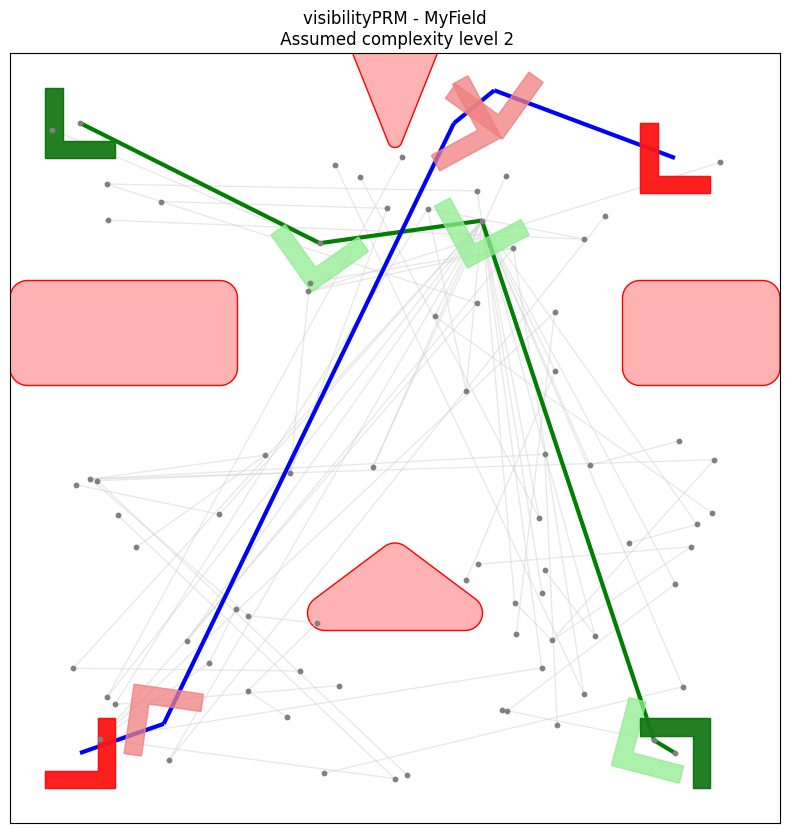

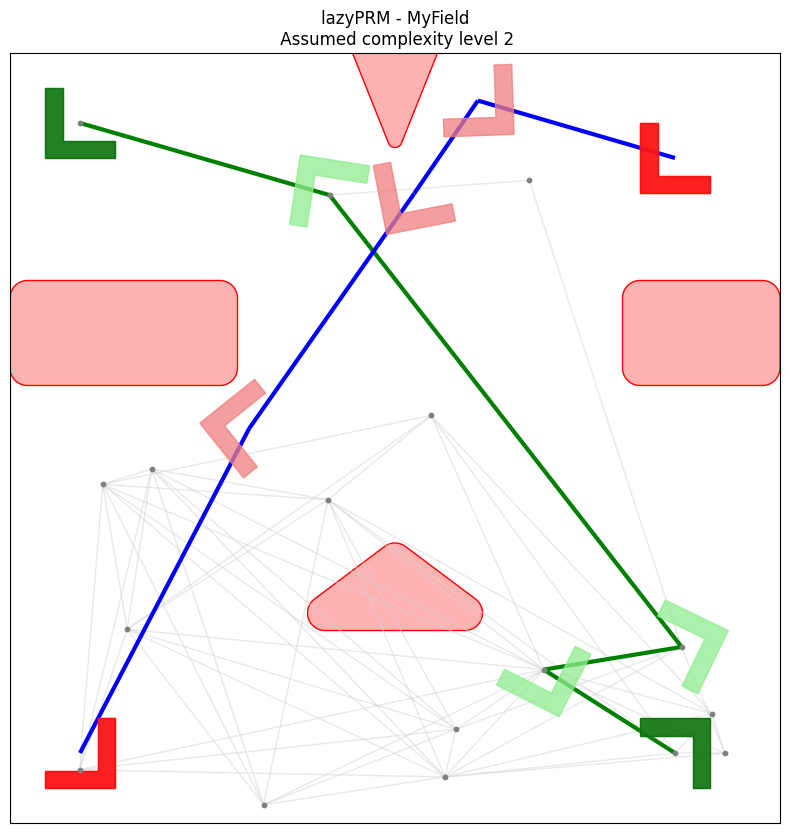

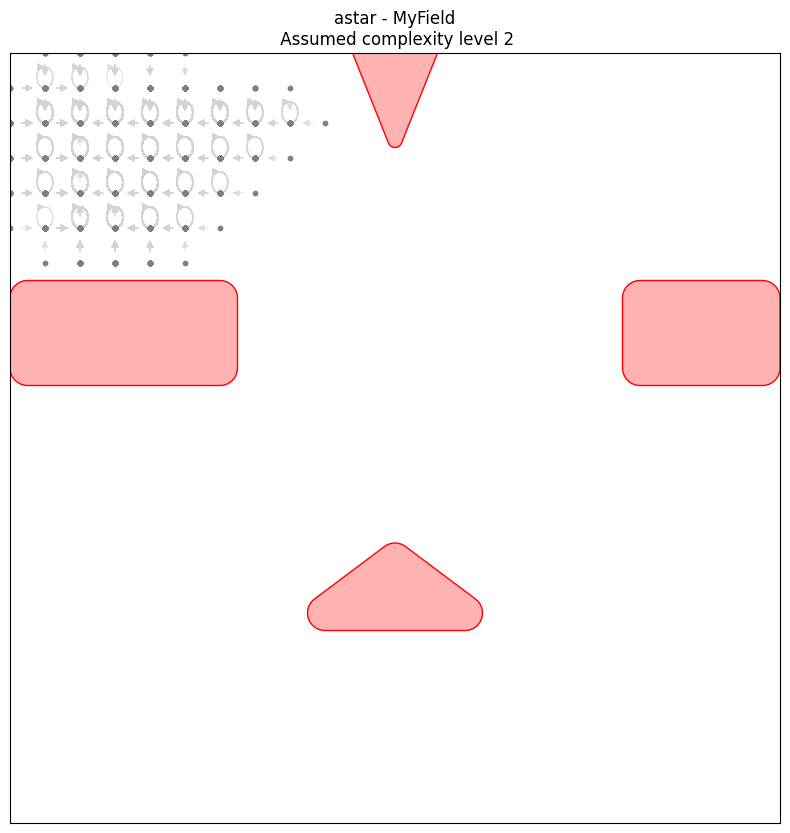

In [8]:
import matplotlib.pyplot as plt

for result in resultList:
    
    fig_local = plt.figure(figsize=(10,10))
    ax = fig_local.add_subplot(1,1,1)
    title = result.plannerFactoryName + " - " + result.benchmark.name
    if result.solution == []:
        title += " (No path found!)"
    title += "\n Assumed complexity level " + str(result.benchmark.level)
    ax.set_title(title)
    try:
        #IPVISBasicsPRM.basicPRMVisualize(result.planner, result.solution, ax=ax, nodeSize=100))
        plannerFactory[result.plannerFactoryName][2](result.planner, result.solution, ax=ax)
    except Exception as e:
        print ("Error", e)
        pass
    

In [26]:
# Starte Animation für die VisibilityPRM-Lösung
# animate_solution_multi(visPRM, environment, solution, visualizer=visualizePRMMulti, step_l=0.2, interval=50)
for bench in testList:
    for result in resultList:
        if result.benchmark.name == bench.name:
            if result.solution is not None :
                print(result.plannerFactoryName)
                animate_solution_multi_downsampled(
                    result.planner, bench.collisionChecker, result.solution,
                    visualizer=visualizePRMMulti,
                    step_l=0.2, interval=50, max_frames=200, figsize=(6,6), dpi=70)

visibilityPRM
Downsampling: 224 -> 200 Frames.
Rendere Animation (240 Frames)...


lazyPRM
Downsampling: 239 -> 200 Frames.
Rendere Animation (240 Frames)...


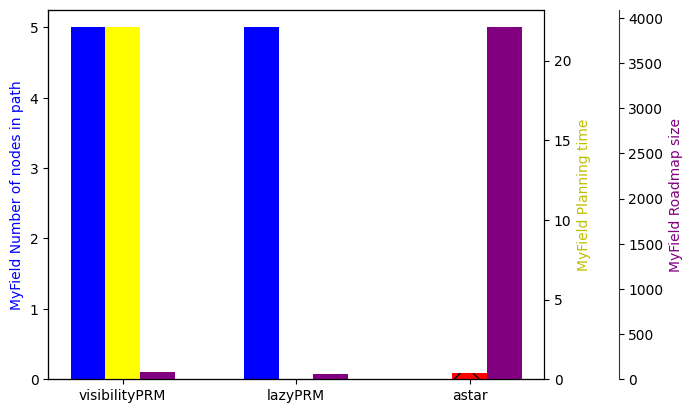

In [27]:
import numpy as np
for bench in testList:
    title = bench.name
    pathLength = dict()
    planningTime = dict()
    roadmapSize  = dict()
    
    try:
        for result in resultList:
            if result.benchmark.name == bench.name:
                #print result.benchmark.name  + " - " +  result.plannerFactoryName, len(result.solution)
                if result.solution is None:
                    curr_len = 0
                else:
                    curr_len = len(result.solution)
                pathLength[result.plannerFactoryName] = curr_len
                planningTime[result.plannerFactoryName] = result.perfDataFrame.groupby(["name"]).sum(numeric_only=True)["time"]["planPath"]
                roadmapSize[result.plannerFactoryName] = result.planner.graph.size()


        fig, ax = plt.subplots()

        width = 0.2

        ax.bar(np.arange(len(pathLength.keys())), pathLength.values(),width, color="blue")
        ax.set_ylabel(title + " Number of nodes in path", color="blue")
        ax.set_xticks(np.arange(len(pathLength.keys())) + width)
        ax.set_xticklabels(pathLength.keys())

        ax2 = ax.twinx()
        bar = ax2.bar(np.arange(len(pathLength.keys()))+width, planningTime.values(),width, color="red")
        ax2.set_ylabel(title + " Planning time", color="y")

        # Add coloring and patterns on axis two
        hatches = ['x' if length==0 else '' for length in pathLength.values()]
        color   = ['red' if length==0 else 'yellow' for length in pathLength.values()]
        for i,thisbar in enumerate(bar.patches):
            thisbar.set_facecolor(color[i])
            thisbar.set_hatch(hatches[i])

        # Multiple axes 
        ax3 = ax.twinx()
        ax3.bar(np.arange(len(pathLength.keys()))+2*width, roadmapSize.values(),width, color="purple")
        ax3.set_ylabel(title + " Roadmap size",  color="purple")
        ax3.spines['right'].set_position(('axes', 1.15))
        ax3.spines['right'].set_color("purple")
    except:
        pass


    
        
    